In [1]:
import pandas as pd
import numpy as np
import os
import matplotlib.pyplot as plt
import plotly.express as px
import matplotlib
import cv2
import plotly
from tensorflow.keras.models import Sequential, load_model
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_percentage_error, mean_absolute_error

2025-07-19 14:13:27.849053: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-07-19 14:13:27.964476: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:467] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1752956008.014869    5121 cuda_dnn.cc:8579] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1752956008.029292    5121 cuda_blas.cc:1407] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
W0000 00:00:1752956008.125157    5121 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking 

## Lectura de datos

In [2]:
seed = 666
np.random.seed(seed)

In [3]:
df = pd.read_csv('metadata.txt', sep='|')

In [4]:
df

,img,n_rooms,n_bathrooms,area,zipcode,price
0,1613,5,3.0,2533,94565,540000
1,1656,3,2.0,1640,93446,425000
2,1580,4,2.0,1881,96019,245000
3,1721,4,3.5,3029,91901,825000
4,1581,2,2.0,1240,92276,117000
...,...,...,...,...,...,...
530,2051,3,3.5,2724,94501,1150000
531,1685,3,2.5,1678,94501,668000
532,1883,5,4.5,5000,93111,4000000
533,1533,3,2.0,1806,92276,179000


In [5]:
imagenes_train = {}
for imagen in os.listdir('./train'):
    if imagen.lower().endswith('jpg'):
        img = imagen.split('_')[0]
        foto = imagen.split('_')[1].split('.')[0]
        if img not in imagenes_train:
            imagenes_train[img] = {}

        imagenes_train[img][foto] = imagen

In [6]:
imagenes_train['2023']

{'frontal': '2023_frontal.jpg',
 'bathroom': '2023_bathroom.jpg',
 'bedroom': '2023_bedroom.jpg',
 'kitchen': '2023_kitchen.jpg'}

In [7]:
df_img = pd.DataFrame.from_dict(imagenes_train, orient = 'index')

In [8]:
df_img

,frontal,bathroom,bedroom,kitchen
2023,2023_frontal.jpg,2023_bathroom.jpg,2023_bedroom.jpg,2023_kitchen.jpg
1715,1715_frontal.jpg,1715_bathroom.jpg,1715_bedroom.jpg,1715_kitchen.jpg
1809,1809_frontal.jpg,1809_bathroom.jpg,1809_bedroom.jpg,1809_kitchen.jpg
1753,1753_frontal.jpg,1753_bathroom.jpg,1753_bedroom.jpg,1753_kitchen.jpg
1958,1958_frontal.jpg,1958_bathroom.jpg,1958_bedroom.jpg,1958_kitchen.jpg
...,...,...,...,...
1720,1720_frontal.jpg,1720_bathroom.jpg,1720_bedroom.jpg,1720_kitchen.jpg
1756,1756_frontal.jpg,1756_bathroom.jpg,1756_bedroom.jpg,1756_kitchen.jpg
1759,1759_frontal.jpg,1759_bathroom.jpg,1759_bedroom.jpg,1759_kitchen.jpg
1652,1652_frontal.jpg,1652_bathroom.jpg,1652_bedroom.jpg,1652_kitchen.jpg


In [9]:
df_img.loc['2023', 'bedroom']

'2023_bedroom.jpg'

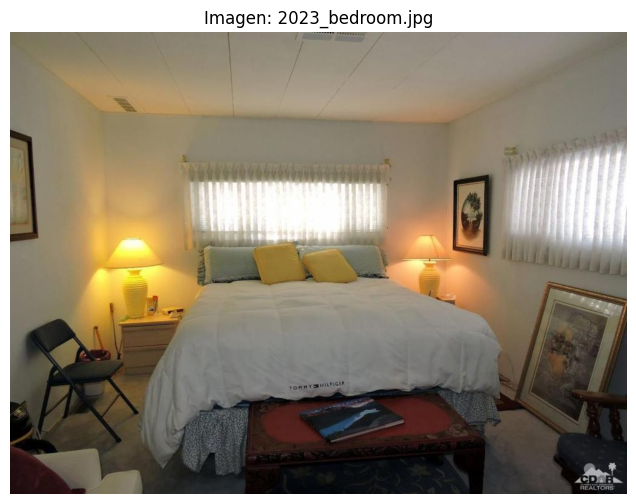

In [10]:
ruta_imagen = f"./train/{df_img.loc['2023', 'bedroom']}"
imagen = matplotlib.image.imread(ruta_imagen)
plt.figure(figsize=(8, 6))
plt.imshow(imagen)
plt.axis('off')  # quita los ejes
plt.title(f"Imagen: {df_img.loc['2023', 'bedroom']}")
plt.show()

In [11]:
df_img_c = df_img.copy()
df_img_c.index = df_img_c.index.astype(int)
df_train = pd.merge(df_img_c, df, left_index=True, right_on='img').reset_index(drop=True)

In [12]:
df_train.isnull().sum()

frontal        0
bathroom       0
bedroom        0
kitchen        0
img            0
n_rooms        0
n_bathrooms    0
area           0
zipcode        0
price          0
dtype: int64

## Analisis Exploratorio

In [13]:
df_train = df_train.drop(columns=['n_rooms','n_bathrooms','area','zipcode'])

In [14]:
df_train

,frontal,bathroom,bedroom,kitchen,img,price
0,2023_frontal.jpg,2023_bathroom.jpg,2023_bedroom.jpg,2023_kitchen.jpg,2023,67500
1,1715_frontal.jpg,1715_bathroom.jpg,1715_bedroom.jpg,1715_kitchen.jpg,1715,154900
2,1809_frontal.jpg,1809_bathroom.jpg,1809_bedroom.jpg,1809_kitchen.jpg,1809,550000
3,1753_frontal.jpg,1753_bathroom.jpg,1753_bedroom.jpg,1753_kitchen.jpg,1753,160000
4,1958_frontal.jpg,1958_bathroom.jpg,1958_bedroom.jpg,1958_kitchen.jpg,1958,114500
...,...,...,...,...,...,...
517,1720_frontal.jpg,1720_bathroom.jpg,1720_bedroom.jpg,1720_kitchen.jpg,1720,515000
518,1756_frontal.jpg,1756_bathroom.jpg,1756_bedroom.jpg,1756_kitchen.jpg,1756,454999
519,1759_frontal.jpg,1759_bathroom.jpg,1759_bedroom.jpg,1759_kitchen.jpg,1759,279900
520,1652_frontal.jpg,1652_bathroom.jpg,1652_bedroom.jpg,1652_kitchen.jpg,1652,154000


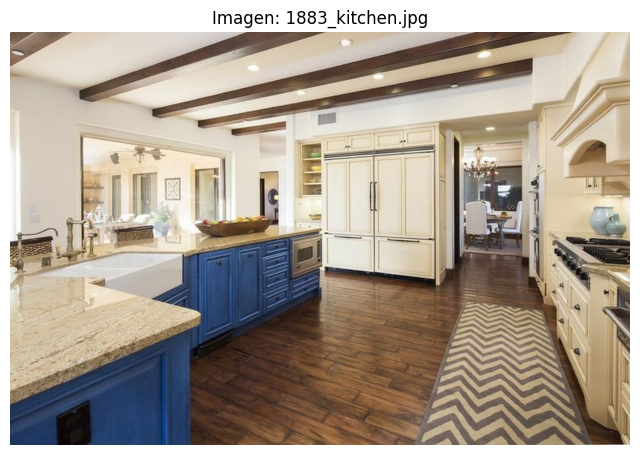

In [15]:
ruta_imagen = f"./train/{df_train.loc[df_train['price'].idxmax(), 'kitchen']}"
imagen = matplotlib.image.imread(ruta_imagen)
plt.figure(figsize=(8, 6))
plt.imshow(imagen)
plt.axis('off')  # quita los ejes
plt.title(f"Imagen: {df_train.loc[df_train['price'].idxmax(), 'kitchen']}")
plt.show()

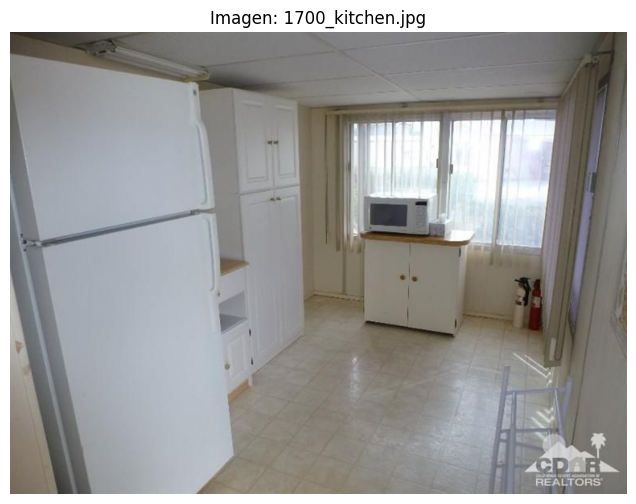

In [16]:
ruta_imagen = f"./train/{df_train.loc[df_train['price'].idxmin(), 'kitchen']}"
imagen = matplotlib.image.imread(ruta_imagen)
plt.figure(figsize=(8, 6))
plt.imshow(imagen)
plt.axis('off')  # quita los ejes
plt.title(f"Imagen: {df_train.loc[df_train['price'].idxmin(), 'kitchen']}")
plt.show()

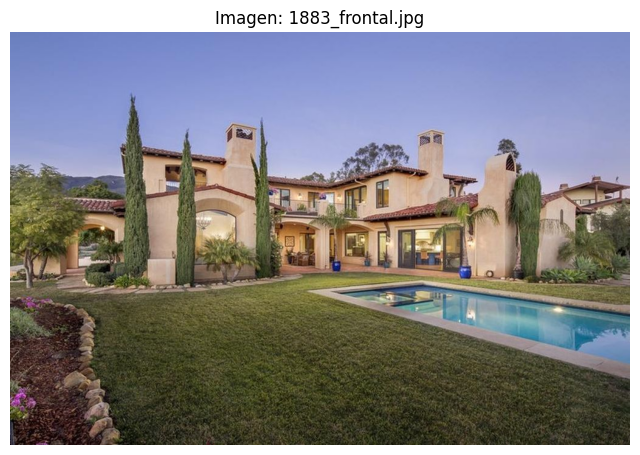

In [17]:
ruta_imagen = f"./train/{df_train.loc[df_train['price'].idxmax(), 'frontal']}"
imagen = matplotlib.image.imread(ruta_imagen)
plt.figure(figsize=(8, 6))
plt.imshow(imagen)
plt.axis('off')  # quita los ejes
plt.title(f"Imagen: {df_train.loc[df_train['price'].idxmax(), 'frontal']}")
plt.show()

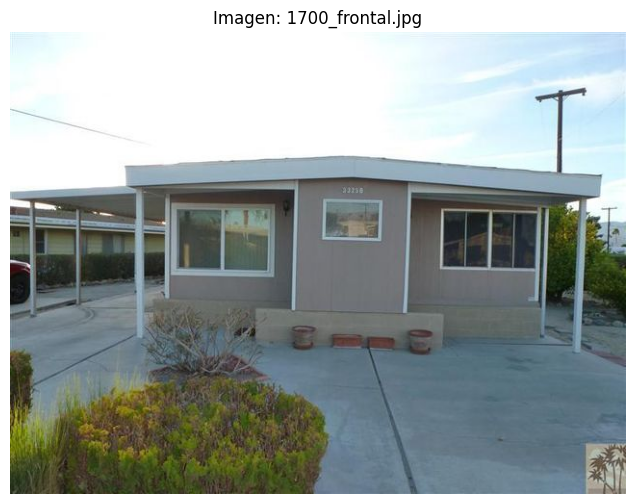

In [18]:
ruta_imagen = f"./train/{df_train.loc[df_train['price'].idxmin(), 'frontal']}"
imagen = matplotlib.image.imread(ruta_imagen)
plt.figure(figsize=(8, 6))
plt.imshow(imagen)
plt.axis('off')  # quita los ejes
plt.title(f"Imagen: {df_train.loc[df_train['price'].idxmin(), 'frontal']}")
plt.show()

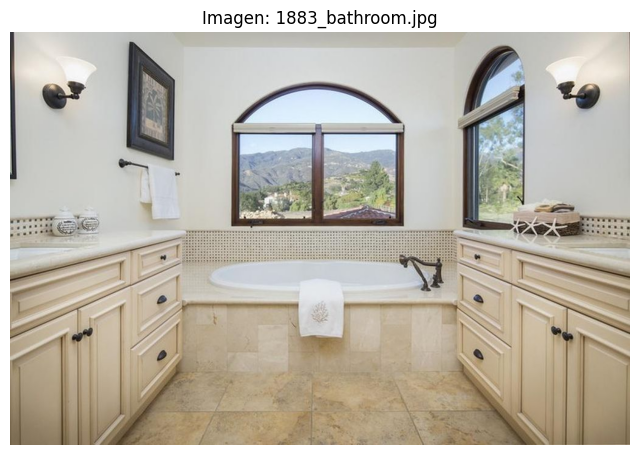

In [19]:
ruta_imagen = f"./train/{df_train.loc[df_train['price'].idxmax(), 'bathroom']}"
imagen = matplotlib.image.imread(ruta_imagen)
plt.figure(figsize=(8, 6))
plt.imshow(imagen)
plt.axis('off')  # quita los ejes
plt.title(f"Imagen: {df_train.loc[df_train['price'].idxmax(), 'bathroom']}")
plt.show()

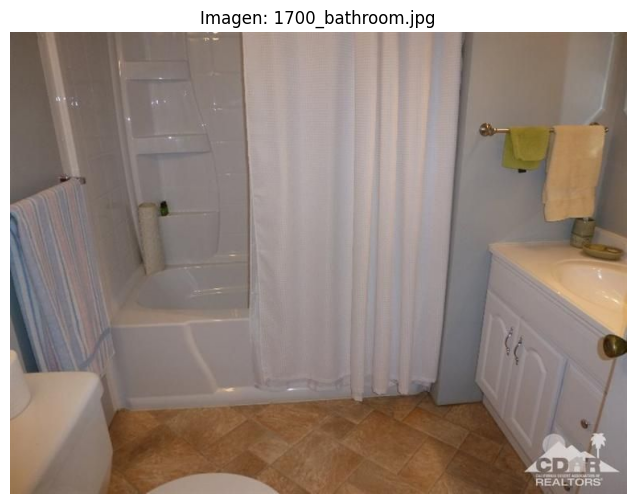

In [20]:
ruta_imagen = f"./train/{df_train.loc[df_train['price'].idxmin(), 'bathroom']}"
imagen = matplotlib.image.imread(ruta_imagen)
plt.figure(figsize=(8, 6))
plt.imshow(imagen)
plt.axis('off')  # quita los ejes
plt.title(f"Imagen: {df_train.loc[df_train['price'].idxmin(), 'bathroom']}")
plt.show()

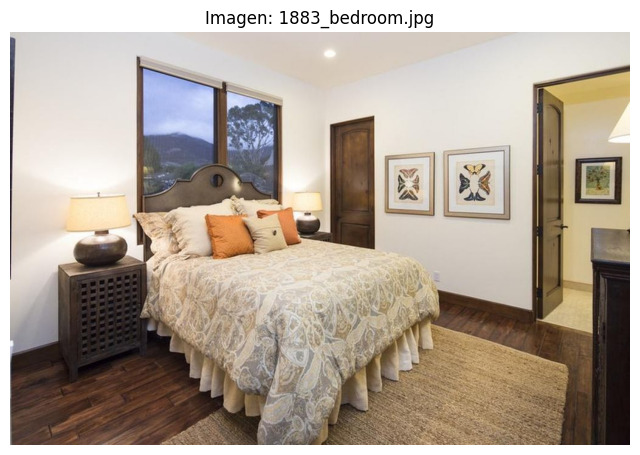

In [21]:
ruta_imagen = f"./train/{df_train.loc[df_train['price'].idxmax(), 'bedroom']}"
imagen = matplotlib.image.imread(ruta_imagen)
plt.figure(figsize=(8, 6))
plt.imshow(imagen)
plt.axis('off')  # quita los ejes
plt.title(f"Imagen: {df_train.loc[df_train['price'].idxmax(), 'bedroom']}")
plt.show()

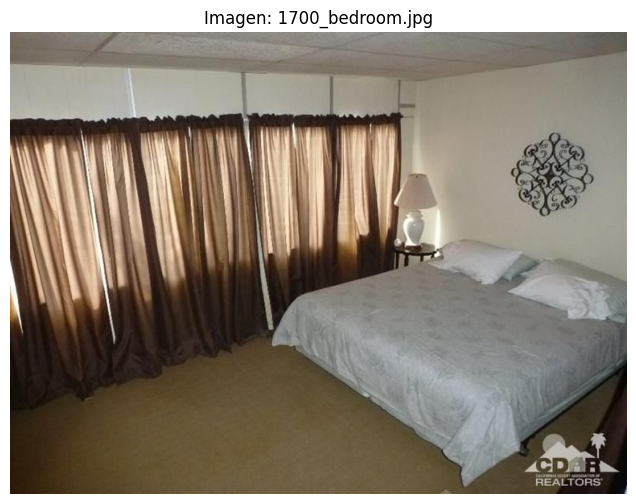

In [22]:
ruta_imagen = f"./train/{df_train.loc[df_train['price'].idxmin(), 'bedroom']}"
imagen = matplotlib.image.imread(ruta_imagen)
plt.figure(figsize=(8, 6))
plt.imshow(imagen)
plt.axis('off')  # quita los ejes
plt.title(f"Imagen: {df_train.loc[df_train['price'].idxmin(), 'bedroom']}")
plt.show()

<Axes: >

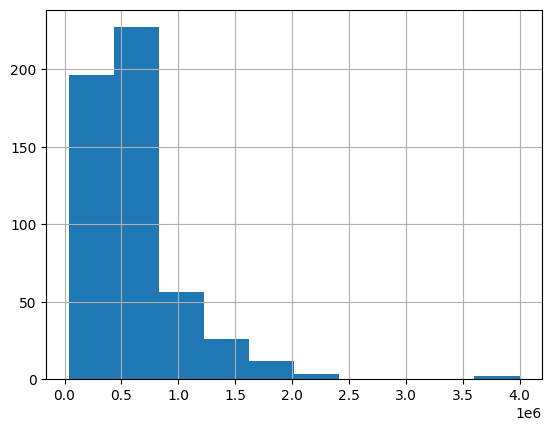

In [23]:
df_train['price'].hist()

In [24]:
df_train['price'].mean()

np.float64(579746.3927203065)

In [33]:
df_train['price'].describe()

count    5.220000e+02
mean     5.797464e+05
std      4.539963e+05
min      3.600000e+04
25%      2.499000e+05
50%      5.290000e+05
75%      7.272500e+05
max      4.000000e+06
Name: price, dtype: float64

In [36]:
df_train[df_train['price'] >= 2.000000e+06]

,frontal,bathroom,bedroom,kitchen,img,price
58,1883_frontal.jpg,1883_bathroom.jpg,1883_bedroom.jpg,1883_kitchen.jpg,1883,4000000
72,1992_frontal.jpg,1992_bathroom.jpg,1992_bedroom.jpg,1992_kitchen.jpg,1992,2150000
282,1543_frontal.jpg,1543_bathroom.jpg,1543_bedroom.jpg,1543_kitchen.jpg,1543,3850000
431,1796_frontal.jpg,1796_bathroom.jpg,1796_bedroom.jpg,1796_kitchen.jpg,1796,2200000
454,1644_frontal.jpg,1644_bathroom.jpg,1644_bedroom.jpg,1644_kitchen.jpg,1644,2395000


## Modelo

In [25]:
X = []
y = []
img_size = (224, 224)
fotos = ['frontal','kitchen','bathroom','bedroom']
for _, row in df_train.iterrows():
    imgs = []
    for v in fotos:
        img = cv2.imread(f"./train/{row[v]}")
        img = cv2.resize(img, img_size) / 255.0
        imgs.append(img)
    top = np.hstack([imgs[0], imgs[1]])
    bottom = np.hstack([imgs[2], imgs[3]])
    mosaic = np.vstack([top,bottom])
    X.append(mosaic) 
    y.append(row['price'])

In [26]:
np.min(y)

np.int64(36000)

In [27]:
np.max(y)

np.int64(4000000)

In [28]:
X = np.array(X)
y = np.array(y).reshape(-1,1)

In [29]:
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.05, random_state=seed)

In [30]:
#mM_sc = MinMaxScaler() ## Usar inverse Transform
y_train_sc = np.log1p(y_train)
y_test_sc = np.log1p(y_test)
#y_train_sc = mM_sc.fit_transform(y_train_log)
#y_test_sc = mM_sc.transform(y_test_log)

In [31]:
fig = px.histogram(
    y_train_sc
)

fig.show()

In [32]:
datagen = ImageDataGenerator(
    rotation_range=15,           
    width_shift_range=0.1,       
    height_shift_range=0.1,      
    horizontal_flip=True,        
    zoom_range=0.1,             
    brightness_range=[0.9, 1.1],
    shear_range=0.1,
    channel_shift_range=0.1,
    fill_mode='nearest' 
) 

In [33]:
model = Sequential([
    Conv2D(32, (5, 5), padding='same',activation='relu', input_shape=(448, 448, 3)),
    MaxPooling2D(2, 2),
    #Dropout(0.1),
    Conv2D(64, (5, 5),padding='same', activation='relu'),
    MaxPooling2D(2, 2),
    #Dropout(0.1),
    Conv2D(128, (5, 5), padding='same',activation='relu'),
    MaxPooling2D(2, 2),
    
    #Conv2D(264, (5, 5), padding='same',activation='relu'),
    #MaxPooling2D(2, 2),
    #Dropout(0.1),
    Flatten(),
    Dense(32, activation='relu'),
    #Dropout(0.1),
    #Dense(32, activation='relu'),
    
    Dense(1)  
])

/home/paul-h-roldan-hernandez/Diplo_env/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.

I0000 00:00:1752867646.187055   12185 gpu_device.cc:2019] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 6141 MB memory:  -> device: 0, name: NVIDIA GeForce RTX 4060 Laptop GPU, pci bus id: 0000:01:00.0, compute capability: 8.9


In [34]:
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 448, 448, 32)   │         2,432 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 224, 224, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 224, 224, 64)   │        51,264 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 112, 112, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 112, 112, 128)  │       204,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 56, 56, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 401408)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 32)             │    12,845,088 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 13,103,745 (49.99 MB)

 Trainable params: 13,103,745 (49.99 MB)

 Non-trainable params: 0 (0.00 B)

In [35]:
model.compile(Adam(learning_rate=0.001),loss='mse',  metrics=['mae'] )

In [36]:
early_stopping = EarlyStopping(monitor = 'val_mae', patience=25, restore_best_weights=True)

In [37]:
Check = ModelCheckpoint('Models/Model_Regresion_real_state_Examen_1.keras',
                                               save_best_only=True,
                                               save_weights_only=False,
                                               monitor='val_mae')

In [38]:
history = model.fit(
    datagen.flow(X_train,y_train_sc, batch_size=8),
    validation_data=(X_test, y_test_sc),
    epochs=100,
    verbose=1,
    callbacks=[early_stopping, Check]
)

/home/paul-h-roldan-hernandez/Diplo_env/lib/python3.12/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning:

Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.



Epoch 1/100


I0000 00:00:1752867658.140109   12406 service.cc:152] XLA service 0x7b2b28003e60 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1752867658.140128   12406 service.cc:160]   StreamExecutor device (0): NVIDIA GeForce RTX 4060 Laptop GPU, Compute Capability 8.9
2025-07-18 13:40:58.180734: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:269] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
I0000 00:00:1752867658.334836   12406 cuda_dnn.cc:529] Loaded cuDNN version 90300


 2/62 ━━━━━━━━━━━━━━━━━━━━ 3s 60ms/step - loss: 166.8253 - mae: 12.8675

I0000 00:00:1752867664.491627   12406 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


62/62 ━━━━━━━━━━━━━━━━━━━━ 27s 326ms/step - loss: 59.6070 - mae: 5.3690 - val_loss: 15.2930 - val_mae: 3.8126
Epoch 2/100
62/62 ━━━━━━━━━━━━━━━━━━━━ 10s 162ms/step - loss: 0.8412 - mae: 0.7397 - val_loss: 21.4415 - val_mae: 4.5560
Epoch 3/100
62/62 ━━━━━━━━━━━━━━━━━━━━ 11s 168ms/step - loss: 0.8331 - mae: 0.7319 - val_loss: 14.1475 - val_mae: 3.6707
Epoch 4/100
62/62 ━━━━━━━━━━━━━━━━━━━━ 10s 162ms/step - loss: 0.9266 - mae: 0.7719 - val_loss: 19.8168 - val_mae: 4.3704
Epoch 5/100
62/62 ━━━━━━━━━━━━━━━━━━━━ 10s 161ms/step - loss: 0.7628 - mae: 0.6731 - val_loss: 25.4497 - val_mae: 4.9728
Epoch 6/100
62/62 ━━━━━━━━━━━━━━━━━━━━ 10s 163ms/step - loss: 1.0174 - mae: 0.8449 - val_loss: 15.4933 - val_mae: 3.8618
Epoch 7/100
62/62 ━━━━━━━━━━━━━━━━━━━━ 10s 167ms/step - loss: 0.9612 - mae: 0.7692 - val_loss: 8.6215 - val_mae: 2.8180
Epoch 8/100
62/62 ━━━━━━━━━━━━━━━━━━━━ 10s 162ms/step - loss: 0.8156 - mae: 0.7117 - val_loss: 32.1791 - val_mae: 5.6094
Epoch 9/100
62/62 ━━━━━━━━━━━━━━━━━━━━ 10s 1

In [39]:
plotly.io.templates.default = 'plotly_dark'
hist_df = pd.DataFrame(model.history.history)
hist_df['epoch'] = range(1, len(hist_df)+1)
fig_acc = px.line(hist_df, x = 'epoch', y = ['mae', 'val_mae'])
fig_acc.show()

In [40]:
best = load_model('./Models/Model_Regresion_real_state_Examen_1.keras')

In [41]:
y_pred_scaled = best.predict(X_test)
#y_pred_log = mM_sc.inverse_transform(y_pred_scaled)
y_pred_real = np.expm1(y_pred_scaled)
#y_test_real_log = mM_sc.inverse_transform(y_test_sc.reshape(-1,1))
y_test_real = np.expm1(y_test_sc.reshape(-1,1))

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


In [42]:
print(mean_absolute_error(y_test_real, y_pred_real))

241862.44675925927


In [43]:
df_plot_test = pd.DataFrame({
    'Precio real': y_test_real.flatten(),
    'Precio predicho': y_pred_real.flatten(),
  
})

In [44]:
fig = px.line(
    df_plot_test,
    x = df_plot_test.index,
    y = ['Precio real','Precio predicho'],
    title = 'Prediccion vs Valor Real Set Test',
    labels={'Precio real': 'Precio Real', 'Precio predicho': 'Precio Predicho'},
)

fig.show()

## Validacion

In [46]:
imagenes_test = {}
for imagen in os.listdir('./validate'):
    if imagen.lower().endswith('jpg'):
        img = imagen.split('_')[0]
        foto = imagen.split('_')[1].split('.')[0]
        if img not in imagenes_test:
            imagenes_test[img] = {}

        imagenes_test[img][foto] = imagen

In [47]:
imagenes_test

{'1904': {'bathroom': '1904_bathroom.jpg',
  'kitchen': '1904_kitchen.jpg',
  'bedroom': '1904_bedroom.jpg',
  'frontal': '1904_frontal.jpg'},
 '1583': {'bathroom': '1583_bathroom.jpg',
  'bedroom': '1583_bedroom.jpg',
  'kitchen': '1583_kitchen.jpg',
  'frontal': '1583_frontal.jpg'},
 '1989': {'frontal': '1989_frontal.jpg',
  'bathroom': '1989_bathroom.jpg',
  'kitchen': '1989_kitchen.jpg',
  'bedroom': '1989_bedroom.jpg'},
 '1707': {'kitchen': '1707_kitchen.jpg',
  'bathroom': '1707_bathroom.jpg',
  'frontal': '1707_frontal.jpg',
  'bedroom': '1707_bedroom.jpg'},
 '1771': {'kitchen': '1771_kitchen.jpg',
  'frontal': '1771_frontal.jpg',
  'bedroom': '1771_bedroom.jpg',
  'bathroom': '1771_bathroom.jpg'},
 '2035': {'bedroom': '2035_bedroom.jpg',
  'kitchen': '2035_kitchen.jpg',
  'frontal': '2035_frontal.jpg',
  'bathroom': '2035_bathroom.jpg'},
 '1859': {'frontal': '1859_frontal.jpg',
  'bedroom': '1859_bedroom.jpg',
  'bathroom': '1859_bathroom.jpg',
  'kitchen': '1859_kitchen.jpg'},

In [48]:
df_validate = pd.DataFrame.from_dict(imagenes_test, orient = 'index')

In [49]:
X_validate = []
for _, row in df_validate.iterrows():
    imgs = [cv2.resize(cv2.imread(f"./validate/{row[v]}"), img_size)/255.0 
            for v in fotos]
    top    = np.hstack(imgs[:2])
    bottom = np.hstack(imgs[2:])
    X_validate.append(np.vstack([top, bottom]))

X_validate = np.array(X_validate)
y_pred_sc = model.predict(X_validate)
#y_pred = mM_sc.inverse_transform(y_pred_sc)
y_pred = np.expm1(y_pred_sc)
df_results = pd.DataFrame({
    'Casa': df_validate.index,
    'Predicción': y_pred.flatten()
})

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


In [50]:
df_results.sort_values(by = 'Casa', ascending = True)

,Casa,Predicción
1,1583,502036.71875
8,1603,609441.62500
9,1608,604689.12500
3,1707,498541.37500
12,1742,461311.96875
4,1771,493466.78125
10,1848,528385.68750
6,1859,502908.84375
0,1904,421599.59375
2,1989,417077.81250
